# Creating synthetic data: 
## From an actual image sequence (warped, pixels remapped)
#### No need to advect, the image sequence has mean motion in it 

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import imageio
from glob import glob 

# https://docs.scipy.org/doc/scipy/reference/generated/scipy.ndimage.map_coordinates.html

import scipy 
from scipy import ndimage

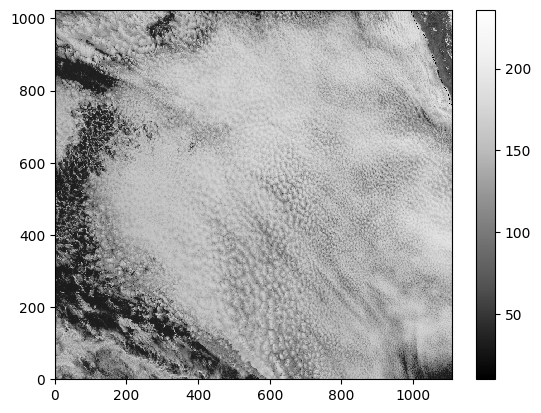

In [2]:


# Define the path to the directory containing the images
path = 'C:\\Users\\ratynski\\Documents\\Python_Projects\\stratocu_waves-main\\DATA\\2022_09_06\\'
# Use glob to find the images in the specified path
fnames = np.sort(glob(path + '*9_06*png'))
images = []

# Read the images and process them
for i, fname in enumerate(fnames):
    img = imageio.v2.imread(fname)
    red = np.flipud(img[:, 400:, 0])
    images.append(red)  # Just red channel, just 400:end in the x dir, flip y

# Plot the first processed image
plt.pcolormesh(images[0], cmap='Greys_r')
plt.colorbar()
plt.show()


In [3]:
# Get the dimensions of the image
height, width = red.shape[:2]

# Create 2D arrays of x and y
x = np.arange(width)
y = np.arange(height)

# Create a meshgrid of x and y
X, Y = np.meshgrid(x, y)


# Pixel size: nominal for MKS units to pixel units 
DX = 2000             # m, pixel size (nominal)

# Xm and Ym are Coordinates in meters, distances measured from central point of image
Xm = (X-X.mean())*DX
Ym = (Y-Y.mean())*DX 

-------------------

# Wave parameters for warping and modulating an image

"In one period, 7–9 October 2008, the waves modulated cloud-top-height by up to 400 m peak-to-trough, propagating perpendicular to the synoptic boundary layer flow with phase speed 15.3 m s−1, period ∼1 h and horizontal wavelength 55 km. The gravity waves were observed to be non-dispersive. “ from https://doi.org/10.1002/qj.1952

For a wave moving toward 45 degrees (northeast), define k and l as positive (sin and cos of nav angle). Let's take z = sin( k(x-ct) + l(y-ct) ) which is indeed moving NEward with time. Then u and v are both positive at z crests (sketch it). That means dx and dy are positve when time is 1/4 period later, or when 90deg of phase have been subtracted since t appears with a negative sign in the formula for phase (x-ct). 

In [4]:
# One wave packet 
cphase = 14            # m/s
wavelength = 150*1000. # meters
period = wavelength/cphase 
direction = 225       # navigation angle of FROM direction in degrees (225 = FROM SW, toward NE) 
zamplitude = 100      # meters, vertical displacement
PBLdepth = 1000       # m, divergent winds assumed to be constant through this layer  

# Wavenumbers computed from wavelengths and direction, units radians per meter
k = 2*np.pi/wavelength * np.sin( (direction) *np.pi/180 )   
l = 2*np.pi/wavelength * np.cos( (direction) *np.pi/180 )   

# Amplitude modulation by a big smooth Gaussian 
packet_center_x = -400*1000  # meters, from middle of Xm, Ym coordinates  
packet_center_y = 400*1000   # meters, from middle of Xm, Ym coordinates  
packet_width_x  = 400*1000.  # meters
packet_width_y  = 300*1000.  # meters
Ampwindow = np.exp(-( ((Xm-packet_center_x)/packet_width_x)**2 + \
                      ((Ym-packet_center_y)/packet_width_y)**2 )) 
     
#plt.pcolormesh(Ampwindow); plt.colorbar()

In [5]:
# A second wave packet 
cphase2 = 20            # m/s
wavelength2 = 100*1000. # meters
period2 = wavelength2/cphase2 
direction2 = 140       # navigation angle of FROM direction in degrees (225 = FROM SW, toward NE) 
zamplitude2 = 50      # meters, vertical displacement
PBLdepth2 = 1000       # m, divergent winds assumed to be constant through this layer  

# Wavenumbers computed from wavelengths and direction, units radians per meter
k2 = 2*np.pi/wavelength2 * np.sin( (direction2) *np.pi/180 )   
l2 = 2*np.pi/wavelength2 * np.cos( (direction2) *np.pi/180 )   

# Amplitude modulation by a big smooth Gaussian 
packet_center_x2 = 400*1000  # meters, from middle of Xm, Ym coordinates  
packet_center_y2 = 100*1000   # meters, from middle of Xm, Ym coordinates  
packet_width_x2  = 200*1000.  # meters
packet_width_y2  = 600*1000.  # meters
Ampwindow2 = np.exp(-( ((Xm-packet_center_x2)/packet_width_x2)**2 + \
                      ( (Ym-packet_center_y2)/packet_width_y2)**2 )) 
     

## Animation displays for time-dependent warped imagery texture 

In [6]:
# Constants for this animation 
time_steps = 10            # Number of time steps 
time_resolution = 1800     # seconds, images are half an hour apart

# The resulting image arrays, for animation 
grid = np.zeros((height, width, time_steps))


# BUILD THE WARPED MODULATED IMAGES AT EACH TIME

for it in range(time_steps):
    t = it*time_resolution     # t is in seconds 

# dz measures vertical displacements: let's choose the sine function. Two packets 
    dz = zamplitude \
         * np.sin( k*(Xm - cphase*t)+l*(Ym - cphase*t) ) *Ampwindow 
    dz2 = zamplitude2 \
         * np.sin( k2*(Xm - cphase2*t)+l2*(Ym - cphase2*t) ) *Ampwindow2

# wave dx and dy are 90deg behind phase with dz, prop. to wavelength. 
# DIRECTION: For 45deg (wave going NE), k>0,l>0, dx>0,dy>0 (sketch it). 

    dxy = (zamplitude/PBLdepth)*wavelength \
          * np.sin( k*(Xm - cphase*t)+l*(Ym - cphase*t) -np.pi/2.) /DX
    dx = dxy * np.sin(direction *np.pi/180.) *Ampwindow # why /2? because it is too strong. Pixel units?? 
    dy = dxy * np.cos(direction *np.pi/180.) *Ampwindow

    dxy2= (zamplitude2/PBLdepth2)*wavelength2 \
          * np.sin( k2*(Xm - cphase2*t)+l2*(Ym - cphase2*t) -np.pi/2.) /DX
    dx2= dxy2* np.sin(direction2 *np.pi/180.) *Ampwindow2 
    dy2= dxy2* np.cos(direction2 *np.pi/180.) *Ampwindow2

# Warping by transporting pixels in original red image, wrapping (periodic) for now. SUBTRACT dy and dx in argument. 
    grid[:,:,it] = ndimage.map_coordinates(images[it],[Y-dy-dy2, X-dx-dx2])  

# Modulate (multiply) albedo by a wavy pattern (vertical displacements, 
#           make consistent with xmotion and ymotion arrays above) 
    grid[:,:,it] *= (1 + dz /PBLdepth  *5) 
    grid[:,:,it] *= (1 + dz2/PBLdepth2 *5) 

maxvalue = grid.max()
maxvalue

309.58694301653907

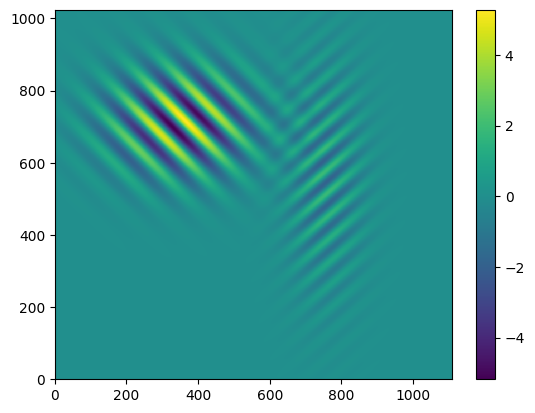

In [7]:
plt.pcolormesh(dy+dy2); plt.colorbar(); # pixels units -- surprising that 7 pixels make such a huge warp?

Best rotation angle (in degrees): -44.7486033519553
Average distance between crests (in pixels): 29.0
Average wavelength: 116.0 km


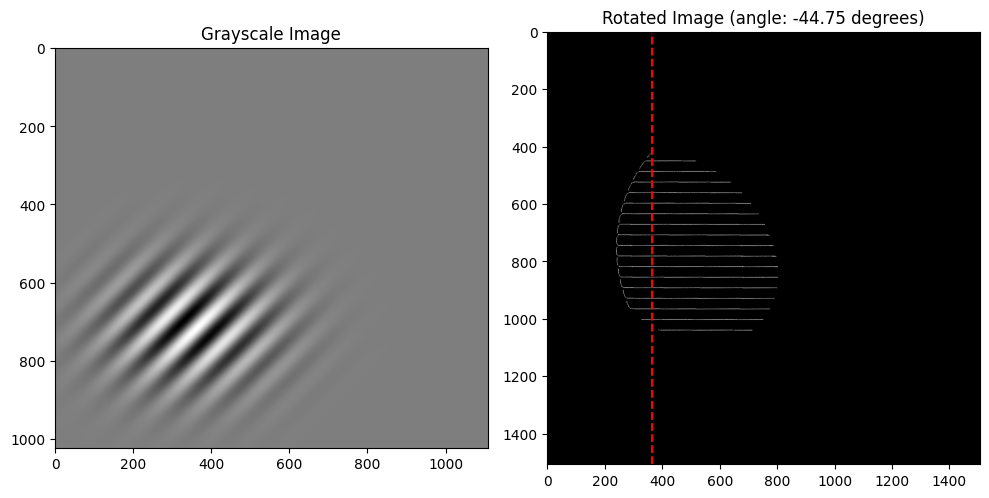

In [390]:
from Eof_functions import Get_Wavelength_From_image

image = dy
best_rotation_angle, avg_distance, wavelength = Get_Wavelength_From_image(image, plot_option=True)


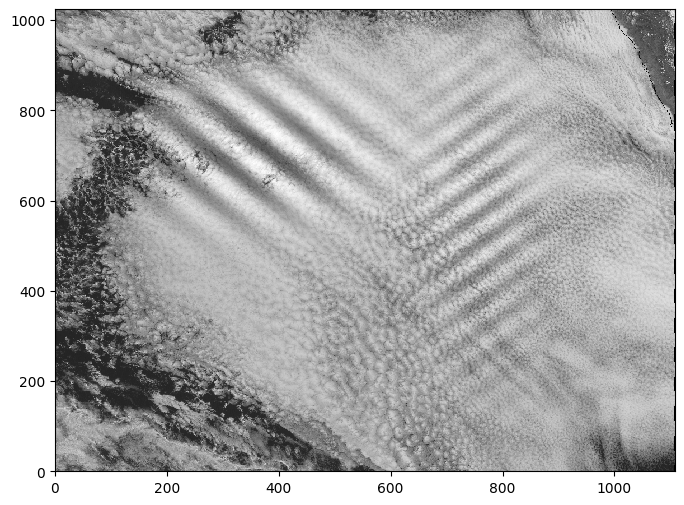

In [8]:
plt.figure(figsize=(8,6))
plt.pcolormesh(grid[:,:,0], cmap='Greys_r')

# Display it! 

# Wavelet experimentation: 2D 



In [9]:
import numpy as np
import pywt
import py_cwt2d
from matplotlib import pyplot as plt

In [10]:
# Subsample to 512x512 to match example 
np.flipud(grid[::2,::2,0][:512,:512]).shape

(512, 512)

In [11]:
# Vignette to reduce edge effects, but too crude, not used 
XX,YY = np.meshgrid(range(512),range(512))
dist = (XX-256)**2 + (YY-256)**2
mask = np.exp(-dist/256/256)

# Choose mother wavelet in the cell below

In [391]:
mother = 'mexh'

# morlet=morlet, mexh=mexh,gaus=gaus,gaus_2=gaus_2,gaus_3=gaus_3,cauchy=cauchy,dog=dog from 
# https://github.com/LeonArcher/py_cwt2d/blob/master/py_cwt2d/mother_wavelets.py

# I manually added the complex morlet wavelet "cmor" to the mother_wavelets.py file
# c:\Program Files (x86)\Microsoft Visual Studio\Shared\Python39_64\lib\site-packages\py_cwt2d\mother_wavelets.py

In [392]:
image = np.flipud(grid[::2,::2,0][:512,:512])  #*mask

# set up a range of scales in logarithmic spacing between 1 and 256 (image width / 2 seems to work here)
# small ss apparently means small scale
ss = np.geomspace(1.0,256.0,100)

# calculate the complex pycwt, and make the wavelet normalization factor CC
coeffs, wav_norm = py_cwt2d.cwt_2d(image, ss, mother)

# normalization factor for each contribution in reconstruction. Is it right? from web repo as found 
CC = 1.0 / (ss * wav_norm) 

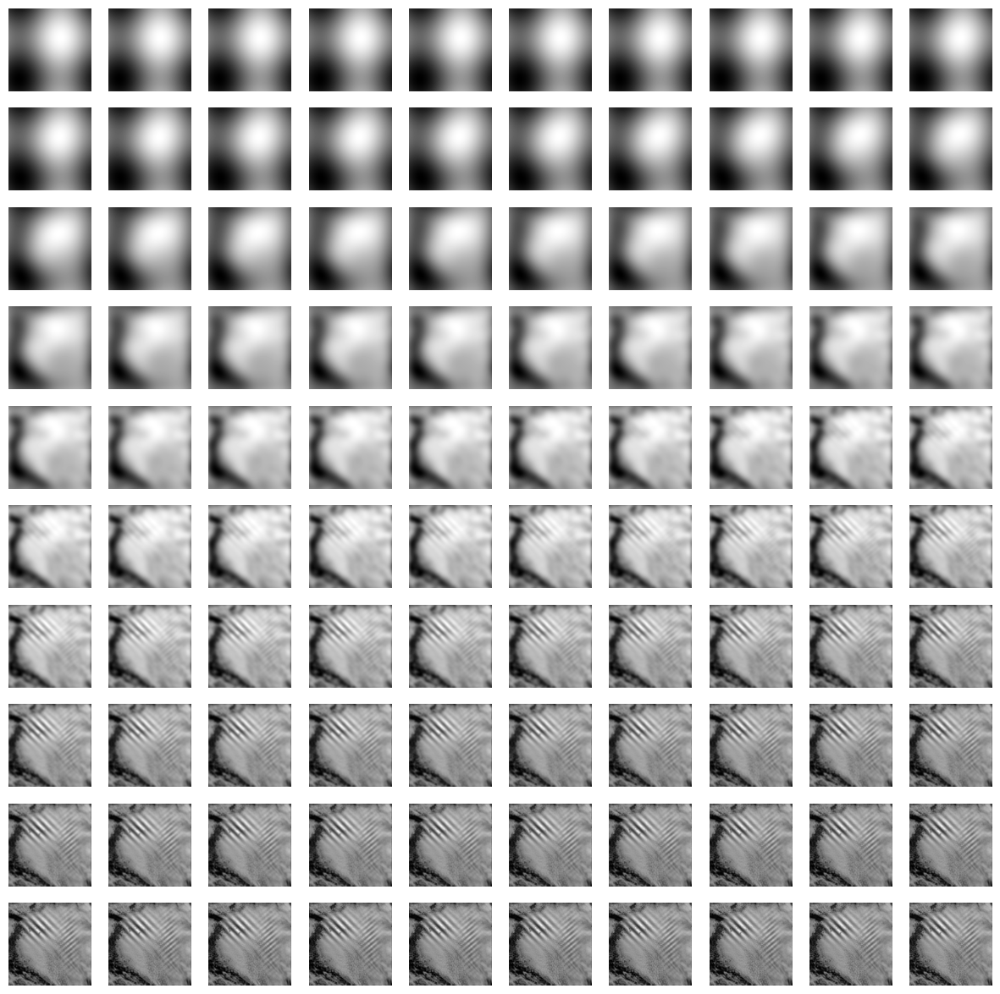

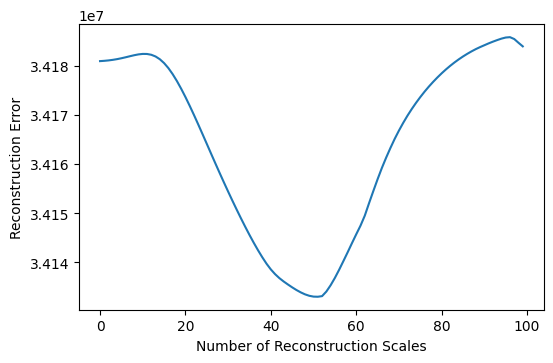

In [27]:
# Show a cumulative reconstruction with truncation level 

errors = [] # container to hold the errors by truncation level 

N = 10  # 10x10 thumbnails, since ss was defined to include 100 scales 

# Plot a successive reconstruction by truncation level
# LARGE TO SMALL scales, reversed(range())

fig, axes = plt.subplots(nrows=N, ncols=N, figsize=(15, 15))

for level in reversed( range(len(ss)) ):
    i = level // N
    j = level % N

# Prepare each thumbnail's area and disable ticks & labels 
    plt.sca(axes[N-1-i, N-1-j]); plt.axis('off')

# Weighted sum is a reconstruction to this truncation level 
    C = CC[level:]
    reconstruction = (C * np.real(coeffs[..., level:])).sum(axis=-1)

# rescale reconstruction to [0,1 range]
# needed since wavelets x scales are not orthogonal
    reconstruction = 1.0 - (reconstruction - reconstruction.min())/ \
                     (reconstruction.max() - reconstruction.min() + 1e-6) # 1e9 prevents /0 error 

# Measure error: fancy power or plain MAE
#    errors.append(np.sqrt(np.sum(np.power(reconstruction - image, 2.0))))
    errors.append(np.mean(np.sum(np.abs(reconstruction - image))))

# Thumbnail image: same [0,1] range in each 
    plt.imshow(reconstruction, cmap='gray', vmin=0, vmax=1)
    
plt.show()

# Second plot: errors as a function of truncation level 
fig2, ax2 = plt.subplots(nrows=1, ncols=1, figsize=(6, 6/1.618))
plt.plot(errors)
plt.xlabel('Number of Reconstruction Scales')
plt.ylabel('Reconstruction Error')
plt.show()

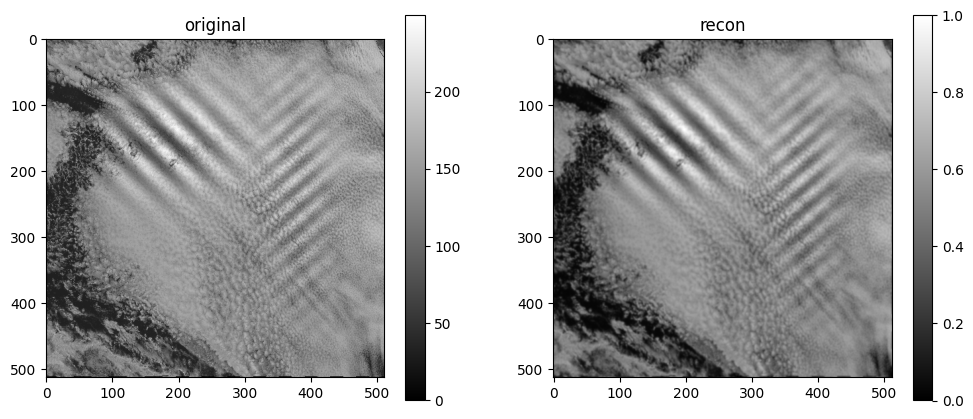

In [28]:
plt.figure( figsize=(12,5) )

plt.subplot(1,2,1)
plt.imshow(image, cmap='gray'); plt.colorbar(); plt.title('original')
plt.subplot(1,2,2)
plt.imshow(reconstruction, cmap='gray'); plt.colorbar(); plt.title('recon');

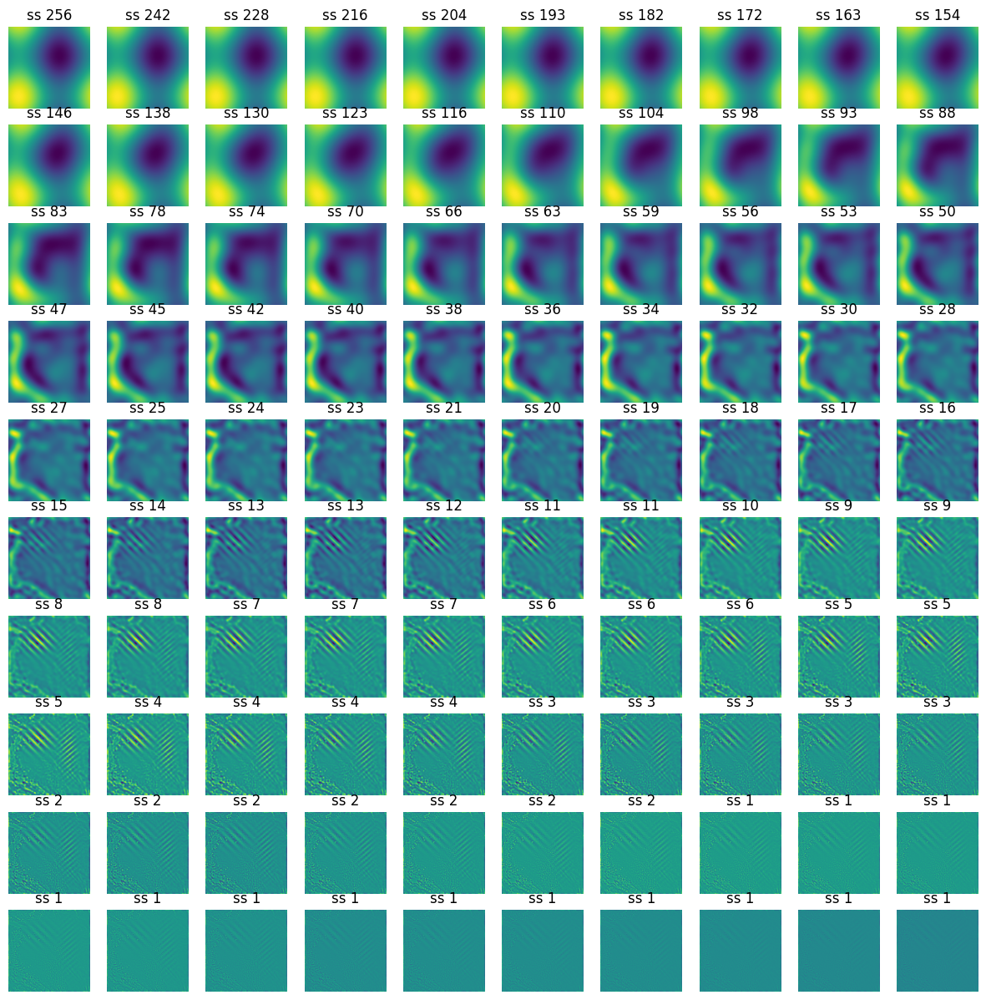

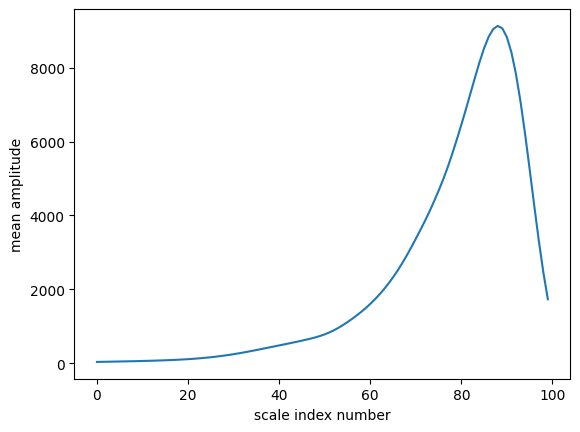

In [29]:
# Scale by scale coefficients, not cumulated, identical color scales [-256,256]

meanamps = [] # container to hold the errors by truncation level 

fig, axes = plt.subplots(nrows=N, ncols=N, figsize=(15, 15))

for level in ( range(len(ss)) ):
    i = level // N
    j = level % N
    
    plt.sca(axes[N-1-i, N-1-j])
    plt.axis('off')
    plt.imshow( np.real(coeffs[:,:,level])) #, vmin=-256,vmax=256) #, cmap='gray')
    plt.title( 'ss '+str(int(ss[level])) )

# Measure area-mean amplitude at this scale (level) 
    meanamps.append( np.mean(np.abs(coeffs[:,:,level])) )
    
plt.show()

# Second plot: amplitudes as a function of scale  
plt.plot(meanamps)
plt.xlabel('scale index number')
plt.ylabel('mean amplitude');

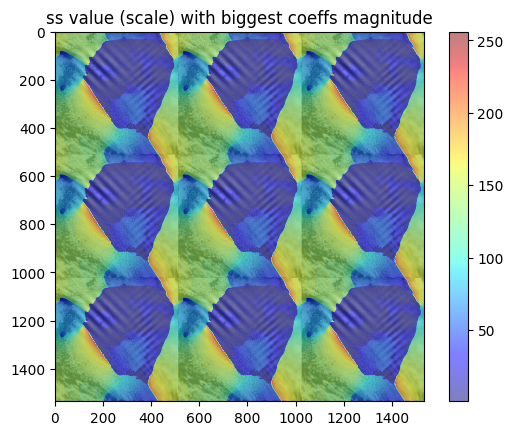

In [393]:
# At each point, what scale has largest amplitude? 
# Tile to show the periodic assumption implicit in wavelet analysis

plt.imshow(np.tile(image,(3,3)), cmap='gray')

#plt.imshow( np.real(coeffs).max(axis=-1), alpha=0.5); plt.colorbar();   # the big amplitude
#plt.imshow( np.real(coeffs).argmax(axis=-1), alpha=0.5); plt.colorbar(); # the scale number it occurs at

plt.imshow( np.tile( ss[np.real(coeffs).argmax(axis=-1)] ,(3,3)), alpha=0.5, cmap='jet'); 

plt.colorbar(); # the ss it occurs at

plt.title('ss value (scale) with biggest coeffs magnitude'); 

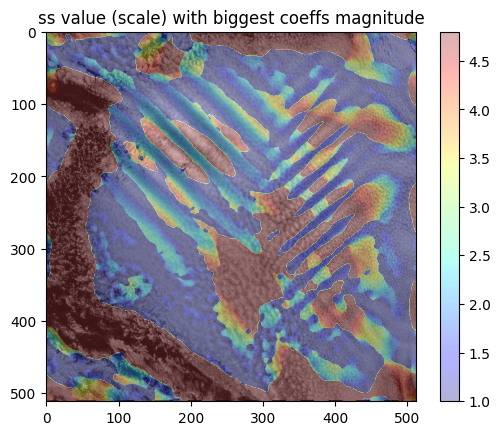

In [394]:
# At each point, what scale has largest amplitude? 
# Among non edge compromised scales 

plt.imshow(image, cmap='gray')

#plt.imshow( np.real(coeffs).max(axis=-1), alpha=0.5); plt.colorbar();   # the big amplitude
#plt.imshow( np.real(coeffs).argmax(axis=-1), alpha=0.5); plt.colorbar(); # the scale number it occurs at

plt.imshow( ss[np.real(coeffs[:,:,np.where( ((ss<25) & (ss>5)).squeeze() )] ).argmax(axis=-1)], alpha=0.3, cmap='jet'); 
plt.colorbar(); # the ss it occurs at

plt.title('ss value (scale) with biggest coeffs magnitude'); 

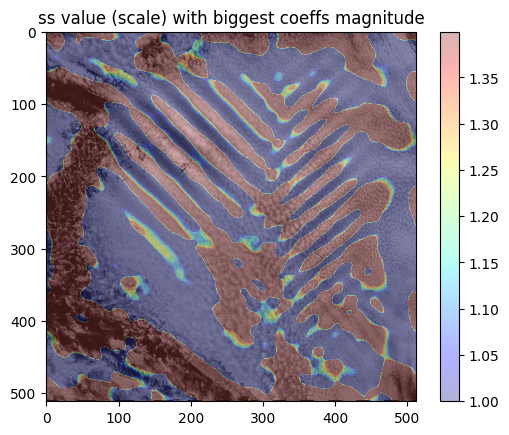

In [395]:
# At each point, what scale has largest amplitude? 
# Among non edge compromised scales 

# image = np.flipud(grid[::2,::2,0][:512,:512])
plt.imshow(image, cmap='gray')

#plt.imshow( np.real(coeffs).max(axis=-1), alpha=0.5); plt.colorbar();   # the big amplitude
#plt.imshow( np.real(coeffs).argmax(axis=-1), alpha=0.5); plt.colorbar(); # the scale number it occurs at

plt.imshow( ss[np.real(coeffs[:,:,np.where( ((ss<15) & (ss>10)).squeeze() )] ).argmax(axis=-1)], alpha=0.3, cmap='jet'); 
plt.colorbar(); # the ss it occurs at

plt.title('ss value (scale) with biggest coeffs magnitude'); 
plt.show()


In [60]:
num_frames = grid.shape[2]

# Initialize arrays to store results for all frames
all_coeffs_mexh = []
all_CC_mexh = []
all_image_scales_mexh = []

all_coeffs_gabor = []
all_CC_gabor = []
all_orientations_gabor = []

# Loop over each frame
for t in range(num_frames):
    # Extract and process the current frame
    image = np.flipud(grid[::2, ::2, t][:512, :512])
    
    # Set up a range of scales in logarithmic spacing between 1 and 256
    ss = np.geomspace(1.0, 256.0, 100)
    
    # Calculate the complex wavelet transform and normalization factor using Mexh wavelets
    coeffs_mexh, wav_norm_mexh = py_cwt2d.cwt_2d(image, ss, 'mexh')
    CC_mexh = 1.0 / (ss * wav_norm_mexh)
    condition = (ss < 15) & (ss > 10)
    indices_mexh = np.where(condition)[0]
    image_scales_mexh = ss[np.real(coeffs_mexh[:, :, indices_mexh]).argmax(axis=-1)]
    
    # Calculate the complex wavelet transform and normalization factor using Gabor wavelets
    coeffs_gabor, wav_norm_gabor = py_cwt2d.cwt_2d(image, ss, 'gabor')
    CC_gabor = 1.0 / (ss * wav_norm_gabor)
    
    # Apply the same condition to the Gabor wavelet scales
    indices_gabor = np.where(condition)[0]
    real_coeffs = np.real(coeffs_gabor[:, :, indices_gabor])
    imag_coeffs = np.imag(coeffs_gabor[:, :, indices_gabor])
    orientations_gabor = np.arctan2(imag_coeffs, real_coeffs)
    average_orientations = np.mean(orientations_gabor, axis=-1)
    
    # Store results for the current frame
    all_coeffs_mexh.append(coeffs_mexh)
    all_CC_mexh.append(CC_mexh)
    all_image_scales_mexh.append(image_scales_mexh)
    
    all_coeffs_gabor.append(coeffs_gabor)
    all_CC_gabor.append(CC_gabor)
    all_orientations_gabor.append(average_orientations)

# Convert lists to numpy arrays for easier handling
all_coeffs_mexh = np.array(all_coeffs_mexh)
all_CC_mexh = np.array(all_CC_mexh)
all_image_scales_mexh = np.array(all_image_scales_mexh)

all_coeffs_gabor = np.array(all_coeffs_gabor)
all_CC_gabor = np.array(all_CC_gabor)
all_orientations_gabor = np.array(all_orientations_gabor)

# Stack lists to numpy arrays, making sure the time dimension is the third one
all_coeffs_mexh = np.stack(all_coeffs_mexh, axis=-1)
all_CC_mexh = np.stack(all_CC_mexh, axis=-1)
all_image_scales_mexh = np.stack(all_image_scales_mexh, axis=-1)

all_coeffs_gabor = np.stack(all_coeffs_gabor, axis=-1)
all_CC_gabor = np.stack(all_CC_gabor, axis=-1)
all_orientations_gabor = np.stack(all_orientations_gabor, axis=-1)

Animation size has reached 23211914 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


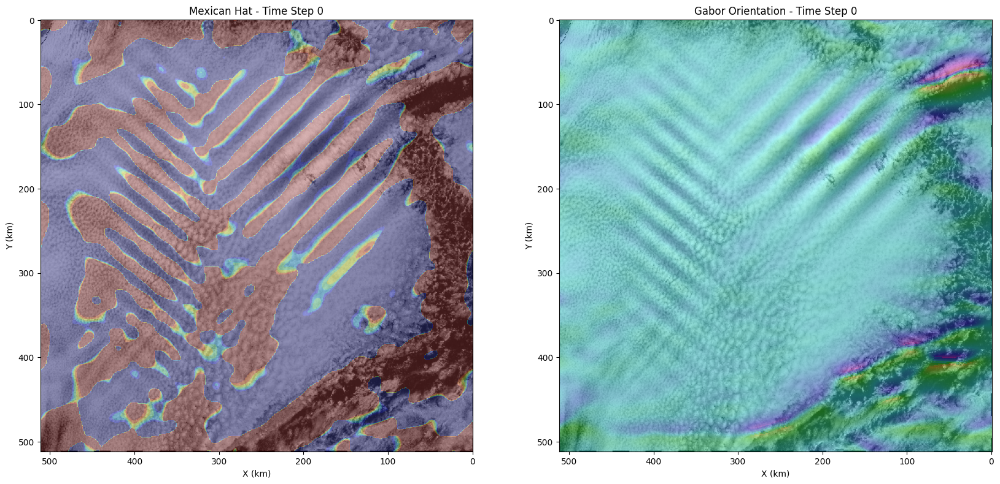

In [61]:
from IPython.display import HTML
import matplotlib.pyplot as plt
import matplotlib.animation as animation

# Create a figure with two subplots side by side
fig, ax = plt.subplots(1, 2, figsize=(20, 10))

# Function to initialize the animation
def init():
    im1 = ax[0].imshow(np.flipud(grid[::2, ::2, 0][:512, :512]), cmap='Greys_r')
    im2 = ax[0].imshow(all_image_scales_mexh[:, :, 0], cmap='jet', alpha=0.3)
    im3 = ax[1].imshow(np.flipud(grid[::2, ::2, 0][:512, :512]), cmap='Greys_r')
    im4 = ax[1].imshow(all_orientations_gabor[:, :, 0], cmap='hsv', alpha=0.5)
    ax[0].invert_xaxis()
    ax[1].invert_xaxis()
    ax[0].set_title(f'Mexican Hat - Time Step 0')
    ax[1].set_title(f'Gabor Orientation - Time Step 0')
    ax[0].set_xlabel('X (km)')
    ax[0].set_ylabel('Y (km)')
    ax[1].set_xlabel('X (km)')
    ax[1].set_ylabel('Y (km)')
    return [im1, im2, im3, im4]

# Function to animate the frames
def animate(it):
    im1 = ax[0].imshow(np.flipud(grid[::2, ::2, it][:512, :512]), cmap='Greys_r')
    im2 = ax[0].imshow(all_image_scales_mexh[:, :, it], cmap='jet', alpha=0.3)
    im3 = ax[1].imshow(np.flipud(grid[::2, ::2, it][:512, :512]), cmap='Greys_r')
    im4 = ax[1].imshow(all_orientations_gabor[:, :, it], cmap='hsv', alpha=0.5)
    ax[0].set_title(f'Mexican Hat - Time Step {it}')
    ax[1].set_title(f'Gabor Orientation - Time Step {it}')
    return [im1, im2, im3, im4]

# Create an animation
ani = animation.FuncAnimation(fig, animate, init_func=init, frames=grid.shape[2], repeat=True)

# Display the animation in the Jupyter Notebook
HTML(ani.to_jshtml())


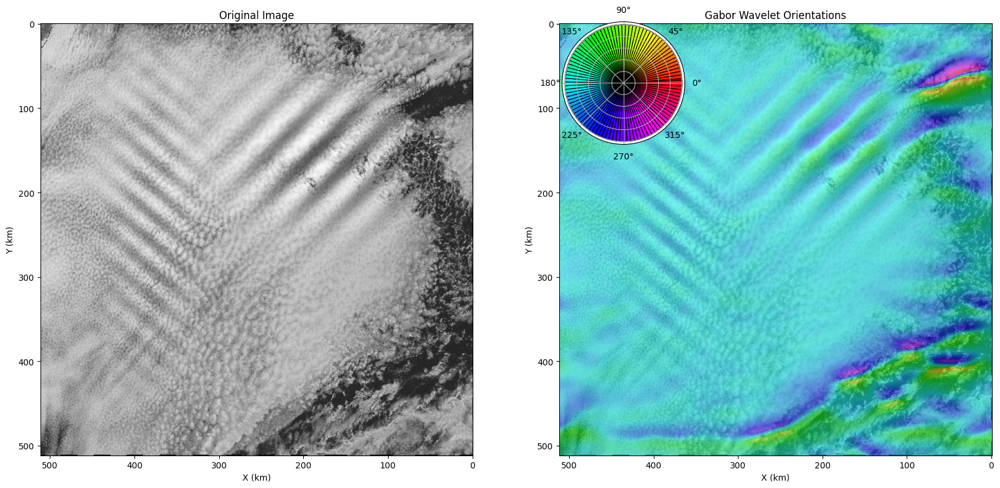

In [59]:
# Extract and process a single frame
frame = 0
image = np.flipud(grid[::2, ::2, frame][:512, :512])

# Set up a range of scales in logarithmic spacing between 1 and 256
ss = np.geomspace(1.0, 256.0, 100)

# Calculate the complex wavelet transform using Gabor wavelets
coeffs_gabor, wav_norm_gabor = py_cwt2d.cwt_2d(image, ss, 'gabor')
CC_gabor = 1.0 / (ss * wav_norm_gabor)

# Apply a condition to the Gabor wavelet scales
condition = (ss < 15) & (ss > 10)
indices_gabor = np.where(condition)[0]

# Calculate orientations based on the Gabor coefficients
real_coeffs = np.real(coeffs_gabor[:, :, indices_gabor])
imag_coeffs = np.imag(coeffs_gabor[:, :, indices_gabor])
orientations_gabor = np.arctan2(imag_coeffs, real_coeffs)
average_orientations = np.mean(orientations_gabor, axis=-1)

# Display the original image and the Gabor wavelet orientations
fig, ax = plt.subplots(1, 2, figsize=(20, 10))

# Display the original image
im1 = ax[0].imshow(image, cmap='Greys_r')
ax[0].invert_xaxis()
ax[0].set_title('Original Image')
ax[0].set_xlabel('X (km)')
ax[0].set_ylabel('Y (km)')

# Normalize the orientation data for better visualization
if np.max(average_orientations) != np.min(average_orientations):
    norm_orientations = (average_orientations - np.min(average_orientations)) / (np.max(average_orientations) - np.min(average_orientations))
else:
    norm_orientations = average_orientations  # Avoid division by zero if the range is zero

# Display the Gabor wavelet orientations
im2 = ax[1].imshow(image, cmap='Greys_r')
im3 = ax[1].imshow(norm_orientations, cmap='hsv', alpha=0.5)
ax[1].invert_xaxis()
ax[1].set_title('Gabor Wavelet Orientations')
ax[1].set_xlabel('X (km)')
ax[1].set_ylabel('Y (km)')

# Create the rose diagram
rose_ax = fig.add_axes([0.55, 0.65, 0.1, 0.2], polar=True)
theta = np.linspace(0, 2*np.pi, 100)
r = np.ones_like(theta)
colors = plt.cm.hsv(theta / (2*np.pi))
rose_ax.bar(theta, r, color=colors, width=0.1, edgecolor='k')
rose_ax.set_yticklabels([])
rose_ax.set_xticks(np.pi/180. * np.linspace(0,  360, 8, endpoint=False))
rose_ax.set_xticklabels(['0°', '45°', '90°', '135°', '180°', '225°', '270°', '315°'])

plt.show()

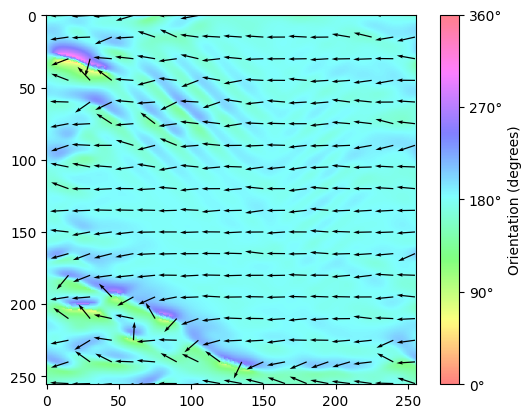

In [160]:
import numpy as np
import matplotlib.pyplot as plt

# Assuming norm_orientations is already defined and it is a 2D numpy array

# Set the resolution factor
resolution_factor = 15  # Adjust this value to make the quiver plot coarser or more fine

# Generate a grid of points for the quiver plot
Y, X = np.mgrid[0:norm_orientations.shape[0]:resolution_factor, 0:norm_orientations.shape[1]:resolution_factor]

# Calculate the direction vectors
U = np.cos(2 * np.pi * norm_orientations[Y, X])
V = np.sin(2 * np.pi * norm_orientations[Y, X])

# Display the image with the 'hsv' colormap
im = plt.imshow(norm_orientations, cmap='hsv', alpha=0.5)

# Overlay the quiver plot with black arrows
plt.quiver(X, Y, U, V, color='black', scale=20)

# Create the colorbar
cbar = plt.colorbar(im)

# Set the colorbar limits to [0, 1] to represent angles in radians
im.set_clim(0, 1)

# Set the colorbar ticks and labels to represent angles in degrees
cbar.set_ticks([0, 0.25, 0.5, 0.75, 1.0])
cbar.set_ticklabels(['0°', '90°', '180°', '270°', '360°'])
cbar.set_label('Orientation (degrees)')

plt.show()


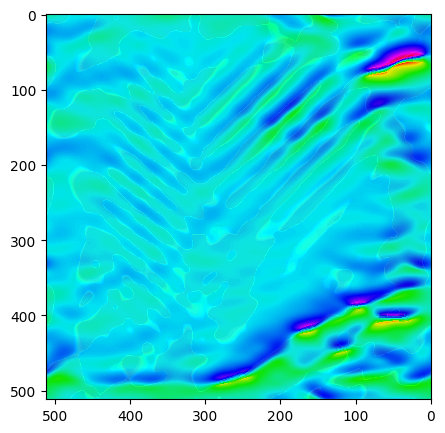

In [170]:
fig, ax = plt.subplots(figsize=(5, 5))

# Display the first image with the 'jet' colormap
im1 = ax.imshow(all_image_scales_mexh[:, :, 0], cmap='jet')

# Overlay the second image with the 'hsv' colormap
im2 = ax.imshow(all_orientations_gabor[:,:,0], cmap='hsv', alpha=0.9)

# Invert x-axis if needed
ax.invert_xaxis()
plt.show()


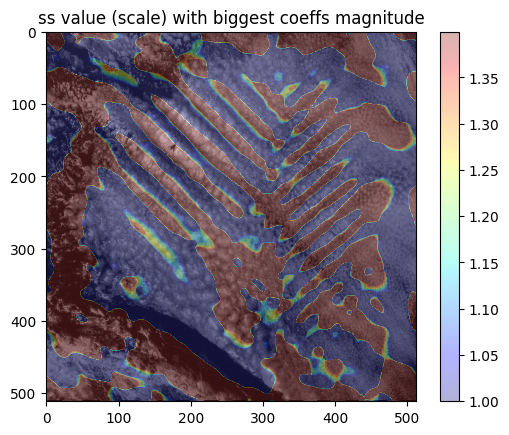

In [179]:
# At each point, what scale has largest amplitude? 
# Among non edge compromised scales 

# image = np.flipud(grid[::2,::2,0][:512,:512])
plt.imshow(image, cmap='gray')

#plt.imshow( np.real(coeffs).max(axis=-1), alpha=0.5); plt.colorbar();   # the big amplitude
#plt.imshow( np.real(coeffs).argmax(axis=-1), alpha=0.5); plt.colorbar(); # the scale number it occurs at

plt.imshow( ss[np.real(coeffs[:,:,np.where( ((ss<15) & (ss>10)).squeeze() )] ).argmax(axis=-1)], alpha=0.3, cmap='jet'); 
plt.colorbar(); # the ss it occurs at

plt.title('ss value (scale) with biggest coeffs magnitude'); 
plt.show()


In [23]:
# Vignette to avoid edges? Naw just take max within acceptable range 
XX,YY = np.meshgrid(range(512),range(512))
dist = (XX-256)**2 + (YY-256)**2
mask = np.exp(-dist/256/256)

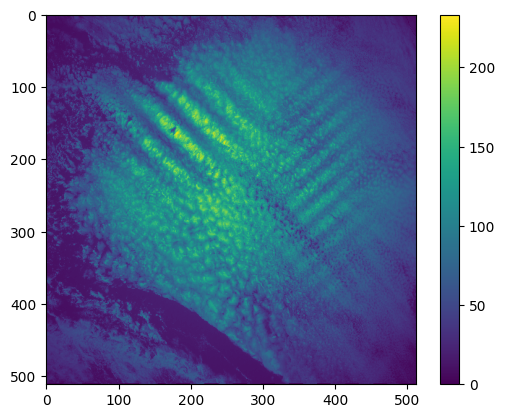

In [24]:
plt.imshow(image*mask); plt.colorbar();